# Installing and importing the libraries

In [14]:
!pip3 install pandas==1.3.1
!pip3 install numpy==1.21.1

In [15]:
!python --version

Python 3.9.7


In [17]:
import pickle

In [18]:
import pandas as pd
import numpy as np

# Accessing the Dataset created earlier

In [19]:
# Accessing the research papers and data

with open('metadata_sample.pickle', 'rb') as f:
  df_metadata = pickle.load(f)
with open('json_pdf_sample.pickle', 'rb') as f:
  df_pdf = pickle.load(f)
with open('json_pmc_sample.pickle', 'rb') as f:
  df_pmc = pickle.load(f)

In [20]:
df_metadata.head()

,cord_uid,sha,source_x,title,doi,pmcid,pubmed_id,license,abstract,publish_time,authors,journal,mag_id,who_covidence_id,arxiv_id,pdf_json_files,pmc_json_files,url,s2_id
863449,dmb9knca,1cbf95a2c3a39e5cc80a5c4c6dbcec7cc718fd59,Elsevier; Medline; PMC,Genomic Evolution of Severe Acute Respiratory ...,10.4103/ijmm.ijmm_20_303,PMC7709607,32883935,els-covid,Abstract Recent emergence of severe acute resp...,2020-08-31,"Jacob, Jobin John; Vasudevan, Karthick; Veerar...",Indian Journal of Medical Microbiology,NaN,NaN,NaN,document_parses/pdf_json/1cbf95a2c3a39e5cc80a5...,NaN,https://api.elsevier.com/content/article/pii/S...,221462995.0
888115,pyf9mafw,7dc6943ca46a1093ece2594002d61efdf9f51f28,Medline; PMC,Impact of COVID-19 on COPD and Asthma admissio...,10.1183/23120541.00822-2020,PMC7734714,33575313,cc-by-nc,Asthma and Chronic Obstructive Pulmonary Disea...,2020-12-10,"Sykes, Dominic L; Faruqi, Shoaib; Holdsworth, ...",ERJ Open Res,NaN,NaN,NaN,document_parses/pdf_json/7dc6943ca46a1093ece25...,NaN,https://www.ncbi.nlm.nih.gov/pubmed/33575313/;...,229181457.0
727674,hnrrlmd4,5b127336f68f3dca83981d0142eda472634378f0,Medline; PMC,Programmable System of Cas13-Mediated RNA Modi...,10.3389/fcell.2021.677587,PMC8353156,34386490,cc-by,Clustered regularly interspaced short palindro...,2021-07-27,"Tang, Tian; Han, Yingli; Wang, Yuran; Huang, H...",Front Cell Dev Biol,NaN,NaN,NaN,document_parses/pdf_json/5b127336f68f3dca83981...,document_parses/pmc_json/PMC8353156.xml.json,https://www.ncbi.nlm.nih.gov/pubmed/34386490/;...,236437455.0
783408,1t9vq9jg,aafbe282248436380dd737bae844725882df2249,Medline; PMC,Are You Tired of Working amid the Pandemic? Th...,10.3390/ijerph17249188,PMC7764790,33316964,cc-by,With the outbreak of novel coronavirus in 2019...,2020-12-09,"Chen, Huaruo; Liu, Fan; Pang, Liman; Liu, Fei;...",Int J Environ Res Public Health,NaN,NaN,NaN,document_parses/pdf_json/aafbe282248436380dd73...,document_parses/pmc_json/PMC7764790.xml.json,https://doi.org/10.3390/ijerph17249188; https:...,229172344.0
786078,050vjj6k,4013a7e351c40d2bb7fdfe7f185d2ef9b1a872e6,Medline; PMC,Viral Sepsis in Children,10.3389/fped.2018.00252,PMC6153324,30280095,cc-by,Sepsis in children is typically presumed to be...,2018-09-18,"Gupta, Neha; Richter, Robert; Robert, Stephen;...",Front Pediatr,NaN,NaN,NaN,document_parses/pdf_json/4013a7e351c40d2bb7fdf...,document_parses/pmc_json/PMC6153324.xml.json,https://www.ncbi.nlm.nih.gov/pubmed/30280095/;...,52291277.0


# Data Merging (merging the data from metadata, json pdf and json pmc files for research papers)

In [21]:
#Merging the metadata and json pdf data
#sha column of metadata and paper_id of json_pdf data are same identifier for each record
df_merged = pd.merge(df_metadata,df_pdf,left_on='sha',right_on='paper_id',how='left').drop('paper_id',axis=1)

In [22]:
df_merged.head(2)
#abstract_x is the abstract from metadata and abstract_y is the abstract from json_pdf

,cord_uid,sha,source_x,title,doi,pmcid,pubmed_id,license,abstract_x,publish_time,...,journal,mag_id,who_covidence_id,arxiv_id,pdf_json_files,pmc_json_files,url,s2_id,abstract_y,body_text
0,dmb9knca,1cbf95a2c3a39e5cc80a5c4c6dbcec7cc718fd59,Elsevier; Medline; PMC,Genomic Evolution of Severe Acute Respiratory ...,10.4103/ijmm.ijmm_20_303,PMC7709607,32883935,els-covid,Abstract Recent emergence of severe acute resp...,2020-08-31,...,Indian Journal of Medical Microbiology,NaN,NaN,NaN,document_parses/pdf_json/1cbf95a2c3a39e5cc80a5...,NaN,https://api.elsevier.com/content/article/pii/S...,221462995.0,"publicly funded repositories, such as the WHO ...",The outbreak of severe acute respiratory syndr...
1,pyf9mafw,7dc6943ca46a1093ece2594002d61efdf9f51f28,Medline; PMC,Impact of COVID-19 on COPD and Asthma admissio...,10.1183/23120541.00822-2020,PMC7734714,33575313,cc-by-nc,Asthma and Chronic Obstructive Pulmonary Disea...,2020-12-10,...,ERJ Open Res,NaN,NaN,NaN,document_parses/pdf_json/7dc6943ca46a1093ece25...,NaN,https://www.ncbi.nlm.nih.gov/pubmed/33575313/;...,229181457.0,,The COVID-19 pandemic has led to an overall re...


In [23]:
#Lets merge the json_pmc data to the merged data too
df_merged = pd.merge(df_merged,df_pmc,left_on='pmcid',right_on='paper_id',how='left').drop('paper_id',axis=1)
df_merged.shape

(25000, 22)

# Data Cleaning and preprocessing

In [24]:
df_merged[df_merged.abstract_x != df_merged.abstract_y].shape

(22728, 22)

In [25]:
# check metadata abstract column to see if null values exist
df_merged.abstract_x.isnull().sum(),(df_merged.abstract_x == '').sum()

(3363, 0)

In [26]:
# Check pdf_json abstract to see if null values exist
df_merged.abstract_y.isnull().sum(),(df_merged.abstract_y == '').sum()

(1526, 6628)

Since the abstract_x from metadata is more reliable , we will use it but only fill by abstract_y text when abstract_x value is null

In [27]:
# Convert all columns to string and then replace abstract_y values
#df = df.astype(str)
df_merged["abstract_y"] = df_merged["abstract_y"].astype(str) 
df_merged['abstract_y'] = np.where(df_merged['abstract_y'].map(len) > 50, df_merged['abstract_y'], "na")

In [28]:
df_merged[df_merged['abstract_y'].apply(lambda x: len(str(x)) <= 10)]

,cord_uid,sha,source_x,title,doi,pmcid,pubmed_id,license,abstract_x,publish_time,...,mag_id,who_covidence_id,arxiv_id,pdf_json_files,pmc_json_files,url,s2_id,abstract_y,body_text_x,body_text_y
1,pyf9mafw,7dc6943ca46a1093ece2594002d61efdf9f51f28,Medline; PMC,Impact of COVID-19 on COPD and Asthma admissio...,10.1183/23120541.00822-2020,PMC7734714,33575313,cc-by-nc,Asthma and Chronic Obstructive Pulmonary Disea...,2020-12-10,...,NaN,NaN,NaN,document_parses/pdf_json/7dc6943ca46a1093ece25...,NaN,https://www.ncbi.nlm.nih.gov/pubmed/33575313/;...,229181457.0,na,The COVID-19 pandemic has led to an overall re...,NaN
7,xiigrx0f,c1f16be9aebe289b891f6500d49a9327117b719f,Medline; PMC; WHO,Analysis of Critical COVID-19 Cases Among Chil...,10.3346/jkms.2022.37.e13,PMC8723896,34981683,cc-by-nc,BACKGROUND: Coronavirus disease 2019 (COVID-19...,2021-12-22,...,NaN,NaN,NaN,document_parses/pdf_json/c1f16be9aebe289b891f6...,document_parses/pmc_json/PMC8723896.xml.json,https://www.ncbi.nlm.nih.gov/pubmed/34981683/;...,245623769.0,na,The clinical spectrum of coronavirus disease 2...,The clinical spectrum of coronavirus disease 2...
10,zcujl8zi,36c9e3dc6067f1227e1d4e38efda862c42fa1b48,Medline; PMC,Letter to the Editor on “Prediction of Knee Ki...,10.1007/s10439-020-02574-1,PMC7370628,32691263,no-cc,The aim of the present Letter was to comment o...,2020-07-20,...,NaN,NaN,NaN,document_parses/pdf_json/36c9e3dc6067f1227e1d4...,document_parses/pmc_json/PMC7370628.xml.json,https://doi.org/10.1007/s10439-020-02574-1; ht...,220648186.0,na,We read with enormous interest the paper ''Pre...,We read with enormous interest the paper “Pred...
11,11meaau3,eaed3fecadba80b2e8fee6e17332bf9a03380b80,Medline; PMC,"Candidaemia in COVID-19, a link to disease pat...",10.1093/cid/ciaa1597,PMC7665401,33070173,no-cc,NaN,2020-10-18,...,NaN,NaN,NaN,document_parses/pdf_json/eaed3fecadba80b2e8fee...,NaN,https://www.ncbi.nlm.nih.gov/pubmed/33070173/;...,224779393.0,na,M a n u s c r i p t 2 Dear Editor:$$$With UK r...,NaN
12,pn4ka7rv,2b40194d26f471e33d629b44936128fe4bca8e7c,Elsevier; Medline; PMC; WHO,The Effect of COVID-19 on Education,10.1016/j.pcl.2021.05.009,PMC8445757,34538299,no-cc,COVID-19 has changed education for learners of...,2021-05-19,...,NaN,NaN,NaN,document_parses/pdf_json/2b40194d26f471e33d629...,document_parses/pmc_json/PMC8445757.xml.json,https://doi.org/10.1016/j.pcl.2021.05.009; htt...,236574126.0,na,"this juncture, but some investigators have ext...",\n\n•Virtual learning has become a norm during...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24993,l6dlm1oq,810a0c8673dbd80fd51b5603850b6075da557c25,Medline; PMC,Effectiveness of virtual reality immersion on ...,10.3344/kjp.2021.34.3.304,PMC8255151,34193636,cc-by-nc,BACKGROUND: The study investigated virtual rea...,2021-07-01,...,NaN,NaN,NaN,document_parses/pdf_json/810a0c8673dbd80fd51b5...,document_parses/pmc_json/PMC8255151.xml.json,https://www.ncbi.nlm.nih.gov/pubmed/34193636/;...,235698804.0,na,Pain has a negative effect on the physical and...,Pain has a negative effect on the physical and...
24994,xyft0f4h,92fa2ce1b951c414ec8fa59166c27d4b7a337435,Elsevier; Medline; PMC; WHO,Anticoagulation in COVID-19,10.1016/s0140-6736(21)02503-4,PMC8673870,34921757,no-cc,NaN,2021-12-15,...,NaN,NaN,NaN,document_parses/pdf_json/92fa2ce1b951c414ec8fa...,document_parses/pmc_json/PMC8673870.xml.json,https://api.elsevier.com/content/article/pii/S...,245145409.0,na,Thrombotic complications (arterial and venous)...,Thrombotic complications (arterial and venous)...
24997,r3r4zwp8,bfef8a33ef8505c73426b177850132ebd098bf5e,PMC,Reisen mit Kindern und Jugendlichen mit rheuma...,10.1007/s00393-021-01002-6,PMC8077853,33904986,no-cc,Due to the underlying disease and immunosuppre...,2021-04-27,...,NaN,NaN,NaN,document_parses/pdf_json/bfef8a33ef8505c73426b...,document_parses/pmc_json/PMC8077853.xml.json,https://www.ncbi.nlm.nih.gov/pmc/articles/PMC8...,NaN,na,"Die Einschätzung, ob ein Kind mit einer 

In [29]:
# replace abstract_x (metadata column) with abstract_y (pdf_json) value where abstract_x is null
df_merged.loc[df_merged.abstract_x.isnull() & (df_merged.abstract_y != 'na'),'abstract_x'] = df_merged[df_merged.abstract_x.isnull() & (df_merged.abstract_y != 'na')].abstract_y

In [30]:

# The null values have reduced which is what was expected.
df_merged.abstract_x.isnull().sum()

2745

In [31]:
# Lets get rid of the pdf_json abstract column and rename the metadata abstract column
df_merged.rename(columns = {'abstract_x' : 'abstract'}, inplace = True)
df_merged.drop('abstract_y',axis=1,inplace = True)
df_merged.columns

Index(['cord_uid', 'sha', 'source_x', 'title', 'doi', 'pmcid', 'pubmed_id',
       'license', 'abstract', 'publish_time', 'authors', 'journal', 'mag_id',
       'who_covidence_id', 'arxiv_id', 'pdf_json_files', 'pmc_json_files',
       'url', 's2_id', 'body_text_x', 'body_text_y'],
      dtype='object')

In [32]:
# This is expected because body text comes from pdf and pmc folders
(df_merged.body_text_x != df_merged.body_text_y).sum()

25000

In [33]:
df_merged.body_text_x.isnull().sum(),(df_merged.body_text_y == '').sum()

(1526, 0)

In [34]:
# This is expected because there are less papers in json_pmc
df_merged.body_text_y.isnull().sum()

5238

In [35]:
# body_text_x is pdf_json. body_text_y comes from pmc_json
# Where available we use the text from pmc file trusting the statement quality
df_merged.body_text_x.isnull().sum(),(df_merged.body_text_y.isnull()).sum()

(1526, 5238)

In [36]:
# There are ~13k rows where body_text_x is null but body_text_y is not null
df_merged.loc[df_merged.body_text_x.isnull() & df_merged.body_text_y.notnull()]

,cord_uid,sha,source_x,title,doi,pmcid,pubmed_id,license,abstract,publish_time,...,journal,mag_id,who_covidence_id,arxiv_id,pdf_json_files,pmc_json_files,url,s2_id,body_text_x,body_text_y
26,dkj0qbcm,5501ea96e42577c082f9fc5bb8635aca9e72a40c; de4e...,Elsevier; Medline; PMC,Detection of SARS-CoV-2 RNA in fecal specimens...,10.1016/j.jinf.2020.06.012,PMC7289116,32535156,no-cc,INTRODUCTION: Recent studies showed that SARS-...,2020-06-11,...,J Infect,NaN,NaN,NaN,document_parses/pdf_json/5501ea96e42577c082f9f...,document_parses/pmc_json/PMC7289116.xml.json,https://doi.org/10.1016/j.jinf.2020.06.012; ht...,219585352.0,NaN,The novel severe acute respiratory syndrome co...
54,t4v5zunk,0aa98e80546e920ee739d0f7145031080a6af8f0; 8e70...,Elsevier; Medline; PMC,Utility of the aged BALB/c mouse model to demo...,10.1016/j.vaccine.2006.11.055,PMC1847333,17227689,bronze-oa,The causative agent of Severe Acute Respirator...,2007-03-01,...,Vaccine,NaN,NaN,NaN,document_parses/pdf_json/0aa98e80546e920ee739d...,document_parses/pmc_json/PMC1847333.xml.json,https://api.elsevier.com/content/article/pii/S...,45454311.0,NaN,The agent that caused the 2002–2003 Severe Acu...
68,5r5my2ga,245036ec36c28a9b53f9334c92b27d1100c4a6d5; 5c93...,Elsevier; Medline; PMC; WHO,Pre-infection HDL-cholesterol levels and morta...,10.1016/j.atherosclerosis.2021.12.009,PMC8692242,34959204,no-cc,BACKGROUND AND AIMS: Low HDL-cholesterol (HDLc...,2021-12-22,...,Atherosclerosis,NaN,NaN,NaN,document_parses/pdf_json/245036ec36c28a9b53f93...,document_parses/pmc_json/PMC8692242.xml.json,https://www.sciencedirect.com/science/article/...,245355867.0,NaN,Severe Acute Respiratory Syndrome Coronavirus ...
72,v2tehu35,9763e1ec1d2cca1b4e4c5ff481742cb3528d533a; 8885...,Elsevier; Medline; PMC,Impaired NLRP3 inflammasome activation/pyropto...,10.1074/jbc.ra120.015036,PMC7549031,32763970,no-cc,Coronaviruses have caused several zoonotic inf...,2020-10-09,...,J Biol Chem,NaN,NaN,NaN,document_parses/pdf_json/9763e1ec1d2cca1b4e4c5...,document_parses/pmc_json/PMC7549031.xml.json,https://api.elsevier.com/content/article/pii/S...,221077456.0,NaN,To systematically investigate the programmed c...
73,q7mfx6pu,efa53b32aa9535db27d5b830c0f2725df60b1b9d; 1e57...,Elsevier; Medline; PMC; WHO,Comparison of suicide attempts among nationall...,10.1016/j.jad.2021.10.111,PMC8563173,34715190,no-cc,BACKGROUND: There is serious concern over the ...,2022-02-01,...,J Affect Disord,NaN,NaN,NaN,document_parses/pdf_json/efa53b32aa9535db27d5b...,document_parses/pmc_json/PMC8563173.xml.json,https://www.ncbi.nlm.nih.gov/pubmed/34715190/;...,240229578.0,NaN,"On March 11, 2020, the World Health Organizati..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24932,d8hj0ehe,ca756d3938bc0cc562fa303350491f37ce95ab4b; 9bfd...,Elsevier; Medline; PMC,Incidence and impact of disseminated intravasc...,10.1016/j.thromres.2021.02.010,PMC7886625,33631519,no-cc,OBJECTIVES: Coronavirus disease 2019 (COVID-19...,2021-02-17,...,Thromb Res,NaN,NaN,NaN,document_parses/pdf_json/ca756d3938bc0cc562fa3...,document_parses/pmc_json/PMC7886625.xml.json,https://www.ncbi.nlm.nih.gov/pubmed/33631519/;...,231938525.0,NaN,"At the end of 2019, hospitals reported a clust..."
24945,kwwbfuxc,ed6be0c68f441745636b47e1c786a64dba87021a; 641b...,BioRxiv; Medline; PMC; WHO,"Delta breakthrough infections elicit potent, b...",10.1101/2021.12.08.471707,PMC8687475,34931192,cc-by-nc-nd,The SARS-CoV-2 Delta variant is currently resp...,2021-12-13,...,bioRxiv,NaN,NaN,NaN,document_parses/pdf_json/ed6be0c68f441745636b4...,document_parses/pmc_json/PMC8687475.xml.json,https://www.ncbi.nlm.nih.gov/pubmed/34931192/;...,245062114.0,NaN,Blood samples were collected from participants...
24952,cl2mo7zu,dd66a50e310d3a543e4dcbeda7d663145981c729; 75e8...,MedRxiv; Medline; PMC; WHO,Histopathological assessments reveal retinal v...,10.1101/2021.02.25.21251531,PMC7924297,33655272,cc-by-nd,PURPOSE: To assess for histopathological chang...,2021-02-28,...

In [37]:
# The text from the pmc folder will be of higher quality because it is full text 
# Hence we will replace with body_text_x with body_text_y where body_text_y exists
df_merged.loc[df_merged.body_text_y.notnull(),'body_text_x'] = df_merged.loc[df_merged.body_text_y.notnull(), 'body_text_y']

In [38]:
# Getting rid of the pdf_pmc body text column and renaming the body text column
df_merged.rename(columns = {'body_text_x' : 'body_text'}, inplace = True)
df_merged.drop('body_text_y',axis=1,inplace = True)
df_merged.columns

Index(['cord_uid', 'sha', 'source_x', 'title', 'doi', 'pmcid', 'pubmed_id',
       'license', 'abstract', 'publish_time', 'authors', 'journal', 'mag_id',
       'who_covidence_id', 'arxiv_id', 'pdf_json_files', 'pmc_json_files',
       'url', 's2_id', 'body_text'],
      dtype='object')

In [39]:
# Body text null values have now decreased.
df_merged.body_text.isnull().sum()

79

In [40]:
df_merged.columns

Index(['cord_uid', 'sha', 'source_x', 'title', 'doi', 'pmcid', 'pubmed_id',
       'license', 'abstract', 'publish_time', 'authors', 'journal', 'mag_id',
       'who_covidence_id', 'arxiv_id', 'pdf_json_files', 'pmc_json_files',
       'url', 's2_id', 'body_text'],
      dtype='object')

In [41]:
df_final = df_merged[['sha', 'title', 'abstract', 'publish_time', 'authors', 'url', 'body_text']]

In [42]:
df_final.head()

,sha,title,abstract,publish_time,authors,url,body_text
0,1cbf95a2c3a39e5cc80a5c4c6dbcec7cc718fd59,Genomic Evolution of Severe Acute Respiratory ...,Abstract Recent emergence of severe acute resp...,2020-08-31,"Jacob, Jobin John; Vasudevan, Karthick; Veerar...",https://api.elsevier.com/content/article/pii/S...,The outbreak of severe acute respiratory syndr...
1,7dc6943ca46a1093ece2594002d61efdf9f51f28,Impact of COVID-19 on COPD and Asthma admissio...,Asthma and Chronic Obstructive Pulmonary Disea...,2020-12-10,"Sykes, Dominic L; Faruqi, Shoaib; Holdsworth, ...",https://www.ncbi.nlm.nih.gov/pubmed/33575313/;...,The COVID-19 pandemic has led to an overall re...
2,5b127336f68f3dca83981d0142eda472634378f0,Programmable System of Cas13-Mediated RNA Modi...,Clustered regularly interspaced short palindro...,2021-07-27,"Tang, Tian; Han, Yingli; Wang, Yuran; Huang, H...",https://www.ncbi.nlm.nih.gov/pubmed/34386490/;...,Prokaryotic clustered regularly interspaced sh...
3,aafbe282248436380dd737bae844725882df2249,Are You Tired of Working amid the Pandemic? Th...,With the outbreak of novel coronavirus in 2019...,2020-12-09,"Chen, Huaruo; Liu, Fan; Pang, Liman; Liu, Fei;...",https://doi.org/10.3390/ijerph17249188; https:...,In the outbreak of novel coronavirus pneumonia...
4,4013a7e351c40d2bb7fdfe7f185d2ef9b1a872e6,Viral Sepsis in Children,Sepsis in children is typically presumed to be...,2018-09-18,"Gupta, Neha; Richter, Robert; Robert, Stephen;...",https://www.ncbi.nlm.nih.gov/pubmed/30280095/;...,"The true incidence of viral sepsis, particular..."


In [43]:
df_final = df_final.dropna(axis=0,subset=['body_text', 'title'])
df_final.isnull().sum()

sha                0
title              0
abstract        2735
publish_time       0
authors          202
url                0
body_text          0
dtype: int64

In [44]:
df_final.shape

(24921, 7)

In [45]:
df_final.to_csv('FINAL_CORD_DATA.csv', index=False)

# Exploratory Data Analysis (EDA)

In [46]:
!pip install seaborn==0.11.1

In [47]:
import seaborn as sns
sns.set_theme(style="darkgrid")
import calendar

# Inspection of final data

In [48]:
#Inspecting the data
def inspect_data(data):
    return pd.DataFrame(
        {
            "Data Type": data.dtypes,
            "No of levels": data.apply(lambda x:len(x.unique()), axis=0),
            "levels": data.apply(lambda x:x.unique(), axis=0),
            "qtd_null": data.apply(lambda x: x.isnull().sum(), axis=0),
            "pct_null": data.apply(lambda x: x.isnull().sum() * 100 / len(x))
        }
    )

In [49]:
inspect_data(df_final)

,Data Type,No of levels,levels,qtd_null,pct_null
sha,object,24921,"[1cbf95a2c3a39e5cc80a5c4c6dbcec7cc718fd59, 7dc...",0,0.000000
title,object,24870,[Genomic Evolution of Severe Acute Respiratory...,0,0.000000
abstract,object,22138,[Abstract Recent emergence of severe acute res...,2735,10.974680
publish_time,object,3038,"[2020-08-31, 2020-12-10, 2021-07-27, 2020-12-0...",0,0.000000
authors,object,24575,"[Jacob, Jobin John; Vasudevan, Karthick; Veera...",202,0.810561
url,object,24921,[https://api.elsevier.com/content/article/pii/...,0,0.000000
body_text,object,24791,[The outbreak of severe acute respiratory synd...,0,0.000000


In [50]:
df_final['publish_time'] = pd.to_datetime(df_final['publish_time'])

In [51]:
df_final['publish_year'] =  df_final['publish_time'].dt.year
df_final['publish_month'] =  df_final['publish_time'].dt.month
df_final['publish_day'] =  df_final['publish_time'].dt.day


In [52]:
df_final['publish_year'].nunique()

51

In [53]:
df_final['publish_year'].min()

1950

In [54]:
df_final['publish_year'].max()

2022

<AxesSubplot:xlabel='publish_year', ylabel='count'>

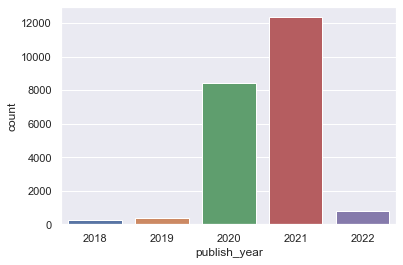

In [55]:
# No.of papers published in recent years
sns.countplot(x="publish_year", data=df_final[df_final['publish_year'].isin([2018, 2019,2020,2021, 2022])])

<AxesSubplot:xlabel='publish_month', ylabel='count'>

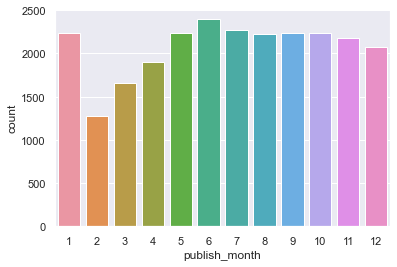

In [56]:
#Month wise distribution of papers published
sns.countplot(x="publish_month", data=df_final)

In [57]:
df_final['publish_month'] = df_final['publish_month'].apply(lambda x : calendar.month_abbr[x])

<AxesSubplot:xlabel='publish_month', ylabel='count'>

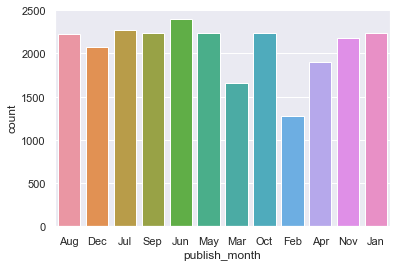

In [58]:
sns.countplot(x="publish_month", data=df_final)

C:\Users\manan\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='in_covid_time', ylabel='count'>

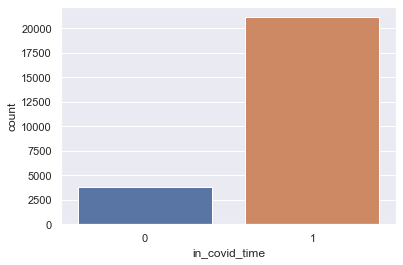

In [59]:
#Checking % of papers published in recent times vs in earlier years
df_final['in_covid_time'] = np.where(df_final['publish_year'].isin([2019,2020,2021]), 1, 0)
sns.countplot(df_final['in_covid_time'])

# Looking at word clouds

In [60]:
!pip3 install wordcloud

In [61]:
from matplotlib import pyplot as plt

In [62]:
from wordcloud import WordCloud, STOPWORDS 
import re
import string

In [63]:
def plot_word_cloud(wordcloud):
    plt.figure(figsize=(10, 10))
    plt.imshow(wordcloud) 
    plt.axis("off");

In [64]:
def remove_special_charac_and_punctuations(text) :
  # define the pattern to keep
  pattern = r'[^a-zA-z0-9\'\s]' 
  txt = re.sub(pattern, '', text)
  txt = ''.join([c for c in txt if c not in string.punctuation])
  return  txt

In [65]:
def concat_all_sentences(sents):
   all_tokens = ''
   for text in sents:
        tx = str(text).lower().strip()
        tx = " ".join(tx.split())
        all_tokens += tx + " "
   return all_tokens  

In [66]:
cleaned_titles = df_final.loc[df_final.title.notnull(), 'title'].apply(remove_special_charac_and_punctuations)

In [67]:
cleaned_abstracts = df_final.loc[df_final.abstract.notnull(), 'abstract'].apply(remove_special_charac_and_punctuations)

In [68]:
title_tokens = concat_all_sentences(cleaned_titles)

In [69]:
abstract_tokens = concat_all_sentences(cleaned_abstracts)

In [70]:
title_tokens

'genomic evolution of severe acute respiratory syndrome coronavirus 2 in india and vaccine impact impact of covid19 on copd and asthma admissions and the pandemic from a patients perspective programmable system of cas13mediated rna modification and its biological and biomedical applications are you tired of working amid the pandemic the role of professional identity and job satisfaction against job burnout viral sepsis in children pandemic catch22 the role of mobility restrictions and institutional inequalities in halting the spread of covid19 five variable that rule your life home mortgage and biostatistical power analysis of critical covid19 cases among children in korea the interplay between covid19 restrictions and vaccination sarscov2 e protein is a potential ion channel that can be inhibited by gliclazide and memantine letter to the editor on prediction of knee kinematics at time of noncontact anterior cruciate ligament injuries based on bone bruises candidaemia in covid19 a link

In [71]:
abstract_tokens

'abstract recent emergence of severe acute respiratory syndrome coronavirus 2 sarscov2 and subsequent containment procedures have impacted the world as never seen before therefore there is considerable curiosity about the genome evolution related to the origin transmission and vaccine impact of this virus we have analysed genome sequences of sarscov2 isolated from indian patients to gain an indepth understanding of genomic evolution and transmission in india phylogenetic analysis and mutation profiling revealed major lineages being evolved by characteristic mutations as the mutation frequency in spike protein is comparatively lesser the candidate vaccines expected to have wide coverage worldwide including india asthma and chronic obstructive pulmonary disease copd patients are considered at increased risk of dying from covid19 and were therefore subject to uk government shielding advice while this may have protected against respiratory viruses adverse effects including reduced physical

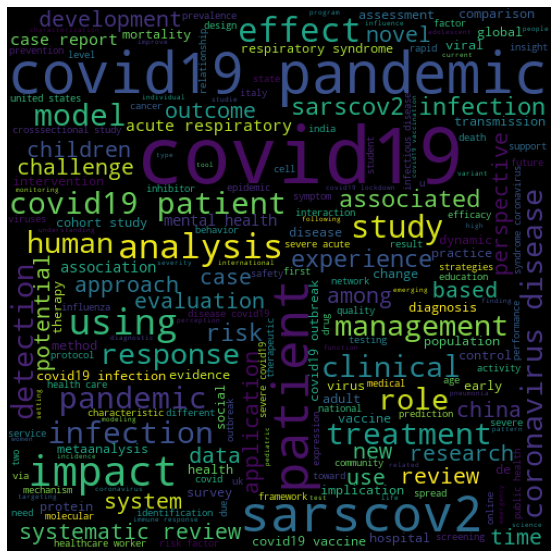

In [72]:
#Looking at word cloud of title tokens
title_wordcloud = WordCloud(width = 500, height = 500,random_state=10).generate(title_tokens)
plot_word_cloud(title_wordcloud)

# Topic Modelling

In [73]:
!pip3 install gensim==3.8.3

  Using cached gensim-3.8.3.tar.gz (23.4 MB)
  Running setup.py clean for gensim
Failed to build gensim
  Attempting uninstall: gensim
    Found existing installation: gensim 4.1.2
    Uninstalling gensim-4.1.2:
      Successfully uninstalled gensim-4.1.2
    Running setup.py install for gensim: started
    Running setup.py install for gensim: finished with status 'error'
  Rolling back uninstall of gensim
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim-4.1.2.dist-info\
   from C:\Users\manan\anaconda3\Lib\site-packages\~ensim-4.1.2.dist-info
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\__init__.py

  ERROR: Command errored out with exit status 1:
   command: 'C:\Users\manan\anaconda3\python.exe' -u -c 'import io, os, sys, setuptools, tokenize; sys.argv[0] = '"'"'C:\\Users\\manan\\AppData\\Local\\Temp\\pip-install-a2s79af9\\gensim_17ff338da2f249e8a61cf48cb3a667e8\\setup.py'"'"'; __file__='"'"'C:\\Users\\manan\\AppData\\Local\\Temp\\pip-install-a2s79af9\\gensim_17ff338da2f249e8a61cf48cb3a667e8\\setup.py'"'"';f = getattr(tokenize, '"'"'open'"'"', open)(__file__) if os.path.exists(__file__) else io.StringIO('"'"'from setuptools import setup; setup()'"'"');code = f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' bdist_wheel -d 'C:\Users\manan\AppData\Local\Temp\pip-wheel-cybd8ofn'
       cwd: C:\Users\manan\AppData\Local\Temp\pip-install-a2s79af9\gensim_17ff338da2f249e8a61cf48cb3a667e8\
  Complete output (461 lines):
  running bdist_wheel
  running build
  running build_py
  creating build
  creating build\lib.win-amd64-3.9
  creat


   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\__init__.py
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\__pycache__\
   from C:\Users\manan\anaconda3\Lib\site-packages\gensim\~_pycache__
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\_matutils.c
   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\_matutils.c
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\_matutils.cp39-win_amd64.pyd
   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\_matutils.cp39-win_amd64.pyd
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\_matutils.pyx
   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\_matutils.pyx
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\corpora\__init__.py
   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\corpora\__init__.py
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\corpora\__pycache__\
   from C:\Users\manan\anaconda3\Lib

  copying gensim\models\ldaseqmodel.py -> build\lib.win-amd64-3.9\gensim\models
  copying gensim\models\lda_dispatcher.py -> build\lib.win-amd64-3.9\gensim\models
  copying gensim\models\lda_worker.py -> build\lib.win-amd64-3.9\gensim\models
  copying gensim\models\logentropy_model.py -> build\lib.win-amd64-3.9\gensim\models
  copying gensim\models\lsimodel.py -> build\lib.win-amd64-3.9\gensim\models
  copying gensim\models\lsi_dispatcher.py -> build\lib.win-amd64-3.9\gensim\models
  copying gensim\models\lsi_worker.py -> build\lib.win-amd64-3.9\gensim\models
  copying gensim\models\nmf.py -> build\lib.win-amd64-3.9\gensim\models
  copying gensim\models\normmodel.py -> build\lib.win-amd64-3.9\gensim\models
  copying gensim\models\phrases.py -> build\lib.win-amd64-3.9\gensim\models
  copying gensim\models\poincare.py -> build\lib.win-amd64-3.9\gensim\models
  copying gensim\models\rpmodel.py -> build\lib.win-amd64-3.9\gensim\models
  copying gensim\models\tfidfmodel.py -> build\lib.win-

In [74]:
!pip3 install spacy

   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\models\__pycache__\lsi_worker.cpython-39.pyc
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\models\__pycache__\lsimodel.cpython-39.pyc
   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\models\__pycache__\lsimodel.cpython-39.pyc
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\models\__pycache__\nmf.cpython-39.pyc
   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\models\__pycache__\nmf.cpython-39.pyc
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\models\__pycache__\normmodel.cpython-39.pyc
   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\models\__pycache__\normmodel.cpython-39.pyc
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\models\__pycache__\phrases.cpython-39.pyc
   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\models\__pycache__\phrases.cpython-39.pyc
  Moving to c:\users\manan\anaconda3\lib\site-pa

  copying gensim\test\svd_error.py -> build\lib.win-amd64-3.9\gensim\test
  copying gensim\test\test_aggregation.py -> build\lib.win-amd64-3.9\gensim\test
  copying gensim\test\test_api.py -> build\lib.win-amd64-3.9\gensim\test
  copying gensim\test\test_atmodel.py -> build\lib.win-amd64-3.9\gensim\test
  copying gensim\test\test_big.py -> build\lib.win-amd64-3.9\gensim\test
  copying gensim\test\test_BM25.py -> build\lib.win-amd64-3.9\gensim\test
  copying gensim\test\test_coherencemodel.py -> build\lib.win-amd64-3.9\gensim\test
  copying gensim\test\test_corpora.py -> build\lib.win-amd64-3.9\gensim\test
  copying gensim\test\test_corpora_dictionary.py -> build\lib.win-amd64-3.9\gensim\test
  copying gensim\test\test_corpora_hashdictionary.py -> build\lib.win-amd64-3.9\gensim\test
  copying gensim\test\test_d2vmodel.py -> build\lib.win-amd64-3.9\gensim\test
  copying gensim\test\test_datatype.py -> build\lib.win-amd64-3.9\gensim\test
  copying gensim\test\test_direct_confirmation.py -


   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\models\ensemblelda.py
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\models\fast_line_sentence.h
   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\models\fast_line_sentence.h
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\models\fasttext.py
   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\models\fasttext.py
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\models\fasttext_corpusfile.cp39-win_amd64.pyd
   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\models\fasttext_corpusfile.cp39-win_amd64.pyd
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\models\fasttext_corpusfile.cpp
   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\models\fasttext_corpusfile.cpp
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\models\fasttext_corpusfile.pyx
   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004k


  copying gensim\test\test_data\fasttext_old -> build\lib.win-amd64-3.9\gensim\test\test_data
  copying gensim\test\test_data\fasttext_old_sep -> build\lib.win-amd64-3.9\gensim\test\test_data
  copying gensim\test\test_data\fasttext_old_sep.syn0_lockf.npy -> build\lib.win-amd64-3.9\gensim\test\test_data
  copying gensim\test\test_data\fasttext_old_sep.syn1neg.npy -> build\lib.win-amd64-3.9\gensim\test\test_data
  copying gensim\test\test_data\fb-ngrams.txt -> build\lib.win-amd64-3.9\gensim\test\test_data
  copying gensim\test\test_data\ft_kv_3.6.0.model.gz -> build\lib.win-amd64-3.9\gensim\test\test_data
  copying gensim\test\test_data\ft_model_2.3.0 -> build\lib.win-amd64-3.9\gensim\test\test_data
  copying gensim\test\test_data\head500.noblanks.cor -> build\lib.win-amd64-3.9\gensim\test\test_data
  copying gensim\test\test_data\head500.noblanks.cor.bz2 -> build\lib.win-amd64-3.9\gensim\test\test_data
  copying gensim\test\test_data\head500.noblanks.cor_tfidf.model -> build\lib.win-a

  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\test\test_data\tfidf_model_3_2.tst
   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\test\test_data\tfidf_model_3_2.tst
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\test\test_data\toy-data.txt
   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\test\test_data\toy-data.txt
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\test\test_data\toy-model-pretrained.bin
   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\test\test_data\toy-model-pretrained.bin
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\test\test_data\toy-model.bin
   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\test\test_data\toy-model.bin
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\test\test_data\toy-model.vec
   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\test\test_data\toy-model.vec
  Moving to c:\users\manan\anaconda3\lib\si

    copying gensim\test\test_data\test_corpus_small.mm -> build\lib.win-amd64-3.9\gensim\test\test_data
    copying gensim\test\test_data\test_glove.txt -> build\lib.win-amd64-3.9\gensim\test\test_data
    copying gensim\test\test_data\test_mmcorpus_corrupt.mm -> build\lib.win-amd64-3.9\gensim\test\test_data
    copying gensim\test\test_data\test_mmcorpus_no_index.mm -> build\lib.win-amd64-3.9\gensim\test\test_data
    copying gensim\test\test_data\test_mmcorpus_no_index.mm.bz2 -> build\lib.win-amd64-3.9\gensim\test\test_data
    copying gensim\test\test_data\test_mmcorpus_no_index.mm.gz -> build\lib.win-amd64-3.9\gensim\test\test_data
    copying gensim\test\test_data\test_mmcorpus_overflow.mm -> build\lib.win-amd64-3.9\gensim\test\test_data
    copying gensim\test\test_data\test_mmcorpus_with_index.mm -> build\lib.win-amd64-3.9\gensim\test\test_data
    copying gensim\test\test_data\test_mmcorpus_with_index.mm.index -> build\lib.win-amd64-3.9\gensim\test\test_data
    copying gensim\

  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\test\utils.py
   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\test\utils.py
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\topic_coherence\
   from C:\Users\manan\anaconda3\Lib\site-packages\gensim\~opic_coherence
  Moving to c:\users\manan\anaconda3\lib\site-packages\gensim\utils.py
   from C:\Users\manan\AppData\Local\Temp\pip-uninstall-jhg004ky\utils.py


In [75]:
!python --version

Python 3.9.7


In [92]:
!python -m spacy download en_core_web_sm

[+] Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')


In [93]:
import gensim, spacy, logging, warnings
import gensim.corpora as corpora
from gensim.utils import lemmatize, simple_preprocess
from gensim.models import CoherenceModel

In [94]:
abstracts = cleaned_abstracts.values.tolist()

In [95]:
#simple_preprocess of genism removes special charcters,numbers and converts into lower case
gensim.utils.simple_preprocess("12 happy today @# '' '\n'", deacc=True) 

['happy', 'today']

In [96]:
def token_builder(sentences) :
   for sent in sentences:     
        sent = gensim.utils.simple_preprocess(str(sent), deacc=True) 
        yield(sent)  



In [97]:
#Building abstract tokens using token_builder
abstract_tokens = list(token_builder(abstracts))

In [98]:
# Build the bigram and trigram models
bigram = gensim.models.Phrases(abstract_tokens, min_count=3, threshold=50) # higher threshold fewer phrases.
trigram = gensim.models.Phrases(bigram[abstract_tokens], threshold=50)  
bigram_mod = gensim.models.phrases.Phraser(bigram)
trigram_mod = gensim.models.phrases.Phraser(trigram)

In [99]:
!pip3 install nltk

In [100]:
import nltk as nltk
nltk.download('stopwords')
nltk.download('punkt')
from nltk.corpus import stopwords

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\manan\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\manan\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [101]:
stop_words = stopwords.words('english')
stop_words.extend(['from', 'subject', 're', 'edu', 'use', 'not', 'would', 'say', 'could', '_', 'be', 'know', 'good', 'go', 'get', 'do', 'done', 'try', 'many', 'some', 'nice', 'thank', 'think', 'see', 'rather', 'easy', 'easily', 'lot', 'lack', 'make', 'want', 'seem', 'run', 'need', 'even', 'right', 'line', 'even', 'also', 'may', 'take', 'come'])

In [102]:

nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner'])

In [105]:
def process_docs(texts, stop_words=stop_words, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
    texts = [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts]
    texts = [bigram_mod[doc] for doc in texts]
    texts = [trigram_mod[bigram_mod[doc]] for doc in texts]
    texts_out = []
    nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner'])
    for sent in texts:
        doc = nlp(" ".join(sent)) 
        texts_out.append([token.lemma_ for token in doc if token.pos_ in allowed_postags])
    # remove stopwords once more after lemmatization   
    texts_out = [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts_out] 
    return texts_out


In [106]:
abstracts_data = process_docs(abstract_tokens)

In [108]:
# Creating a Dictionary
id2word = corpora.Dictionary(abstracts_data)

In [109]:
print(id2word)

Dictionary(71065 unique tokens: ['abstract', 'analyse', 'candidate', 'characteristic', 'comparatively']...)


In [111]:
print(id2word.token2id)

{'abstract': 0, 'analyse': 1, 'candidate': 2, 'characteristic': 3, 'comparatively': 4, 'considerable': 5, 'containment': 6, 'coronavirus': 7, 'coverage': 8, 'curiosity': 9, 'emergence': 10, 'evolution': 11, 'evolve': 12, 'expect': 13, 'frequency': 14, 'gain': 15, 'genome': 16, 'genome_sequence': 17, 'genomic': 18, 'impact': 19, 'include': 20, 'indepth': 21, 'indian': 22, 'isolated': 23, 'less': 24, 'lineage': 25, 'major': 26, 'mutation': 27, 'never': 28, 'origin': 29, 'patient': 30, 'procedure': 31, 'profiling': 32, 'recent': 33, 'related': 34, 'reveal': 35, 'sarscov': 36, 'subsequent': 37, 'therefore': 38, 'transmission': 39, 'understand': 40, 'vaccine': 41, 'virus': 42, 'wide': 43, 'world': 44, 'worldwide': 45, 'adverse_effect': 46, 'advice': 47, 'anxiety': 48, 'asthma': 49, 'clinical': 50, 'condition': 51, 'consequence': 52, 'consider': 53, 'copd': 54, 'covid': 55, 'die': 56, 'disease': 57, 'due': 58, 'experience': 59, 'find': 60, 'government': 61, 'increase': 62, 'lung': 63, 'natio

In [113]:
# Create Corpus: Term Document Frequency
corpus = [id2word.doc2bow(text) for text in abstracts_data]

In [114]:
# Build LDA model
lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=2, 
                                           random_state=100,
                                           update_every=1,
                                           chunksize=10,
                                           passes=10,
                                           alpha='symmetric',
                                           iterations=100,
                                           per_word_topics=True)

In [115]:
#just a statistical equation thing inside the lda
print(lda_model.print_topics())

[(0, '0.016*"covid" + 0.010*"pandemic" + 0.010*"study" + 0.007*"result" + 0.006*"model" + 0.006*"datum" + 0.006*"health" + 0.005*"method" + 0.005*"impact" + 0.004*"high"'), (1, '0.024*"patient" + 0.017*"covid" + 0.010*"infection" + 0.009*"study" + 0.008*"disease" + 0.007*"sarscov" + 0.007*"virus" + 0.007*"result" + 0.006*"high" + 0.006*"treatment"')]


In [116]:
import matplotlib.pyplot as plt

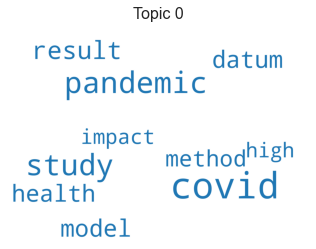

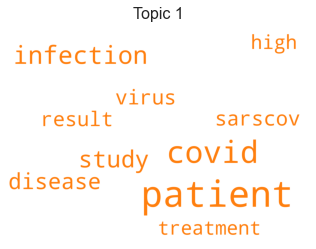

In [117]:
import matplotlib.colors as mcolors

cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'

cloud = WordCloud(stopwords=stop_words,
                  background_color='white',
                  width=2500,
                  height=1800,
                  max_words=10,
                  colormap='tab10',
                  color_func=lambda *args, **kwargs: cols[i],
                  prefer_horizontal=1.0)

topics = lda_model.show_topics(formatted=False)

for i in range(0,2):
    topic_words = dict(topics[i][1])
    cloud.generate_from_frequencies(topic_words, max_font_size=300)
    plt.gca().imshow(cloud)
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
    plt.gca().axis('off')
    plt.show()

In [118]:
topics = lda_model.show_topics(formatted=False)

In [119]:
topics

[(0,
  [('covid', 0.015559395),
   ('pandemic', 0.0099799195),
   ('study', 0.00976719),
   ('result', 0.0067793652),
   ('model', 0.00621861),
   ('datum', 0.006188651),
   ('health', 0.005989819),
   ('method', 0.0054719634),
   ('impact', 0.00457299),
   ('high', 0.0044567524)]),
 (1,
  [('patient', 0.024070745),
   ('covid', 0.01665839),
   ('infection', 0.0103088375),
   ('study', 0.009173435),
   ('disease', 0.008008176),
   ('sarscov', 0.0067904135),
   ('virus', 0.006781545),
   ('result', 0.0065947445),
   ('high', 0.0060768602),
   ('treatment', 0.0060002063)])]